In [18]:
import plotly.graph_objects as go

In [19]:
def make_cube(x, y, z, size):
    # array of cube vertecies
    cube = [
        [x, y, z],
        [x + size, y, z],
        [x + size, y + size, z],
        [x, y + size, z],
        [x, y, z + size], 
        [x + size, y, z + size],
        [x + size, y + size, z + size],
        [x, y + size, z + size]
    ]

    # plotly is only can draw triangle faces, so we make a "square" face, by separating it on two triangle ones
    faces = [
        [cube[0], cube[1], cube[5]],
        [cube[0], cube[5], cube[4]],
        [cube[2], cube[3], cube[7]],
        [cube[2], cube[7], cube[6]],
        [cube[0], cube[3], cube[7]],
        [cube[0], cube[7], cube[4]],
        [cube[1], cube[2], cube[6]],
        [cube[1], cube[6], cube[5]],
        [cube[0], cube[1], cube[2]],
        [cube[0], cube[2], cube[3]],
        [cube[4], cube[5], cube[6]],
        [cube[4], cube[6], cube[7]]
    ]
    return faces

In [26]:
def jerusalem_cube(x, y, z, size, iterations): # to change
    if (iterations == 0):
        return make_cube(x, y, z, size)

    # generate 8 biger cubes
    faces = []

    for i in range(2):
        for j in range(2):
            for k in range(2):                
                faces.extend(jerusalem_cube(x + size*i*(3/5), y + size*j*(3/5), z + size*k*(3/5), (2/5)*size, iterations-1))

    # generate 12 smaler cubes
    size = size / 5
    for k in [0, 4]:
        faces.extend(jerusalem_cube(x, y + 2*size, z + k*size, size, iterations-1))
        faces.extend(jerusalem_cube(x + 2*size, y, z + k*size, size, iterations-1))
        faces.extend(jerusalem_cube(x + 2*size, y + 4*size, z + k*size, size, iterations-1))
        faces.extend(jerusalem_cube(x + 4*size, y + 2*size, z + k*size, size, iterations-1))

    faces.extend(jerusalem_cube(x, y + 4*size, z + 2*size, size, iterations-1))
    faces.extend(jerusalem_cube(x, y, z + 2*size, size, iterations-1))
    faces.extend(jerusalem_cube(x + 4*size, y, z + 2*size, size, iterations-1))
    faces.extend(jerusalem_cube(x + 4*size, y + 4*size, z + 2*size, size, iterations-1))

    return faces

In [27]:
def draw_jerusalem_cube(iterations): # to change
    faces = jerusalem_cube(0, 0, 0, 1, iterations)

    x_vals, y_vals, z_vals, i_vals, j_vals, k_vals = [], [], [], [], [], []

    for it, face in enumerate(faces):
        for vertex in face:
            x_vals.append(vertex[0])
            y_vals.append(vertex[1])
            z_vals.append(vertex[2])
        if len(i_vals) < len(x_vals): # kind of strange stuf, still can't get what the porpouse of this if (it seems that without it, and with for we are getting the same result)
            i_vals.append(3*it)
            j_vals.append(3*it + 1)
            k_vals.append(3*it + 2)

    mesh = go.Mesh3d(x=x_vals, y=y_vals, z=z_vals,
                     i=i_vals, j=j_vals, k=k_vals, facecolor=['cyan']*len(i_vals))
    layout = go.Layout(scene=dict(aspectmode="cube"))
    figure = go.Figure(data=[mesh], layout=layout)
    figure.show()

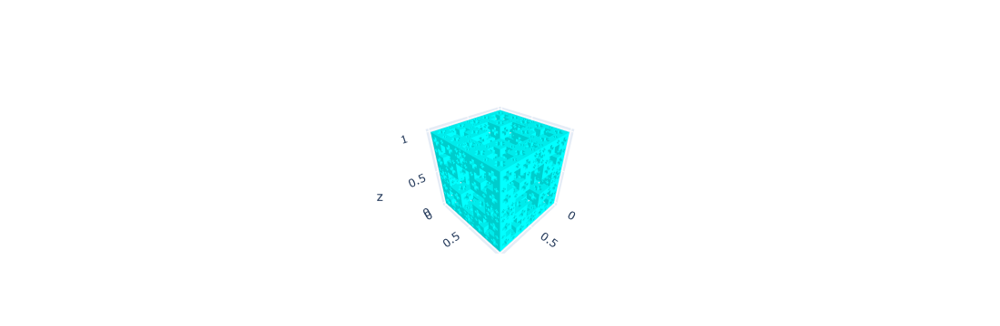

In [30]:
draw_jerusalem_cube(3)